In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import warnings
warnings.filterwarnings('ignore')

# TensorFlow and Keras
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import VGG16, ResNet50
from tensorflow.keras.layers import Dense, Dropout, Flatten, GlobalAveragePooling2D, BatchNormalization
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint

# Sklearn for metrics
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc, roc_auc_score

np.random.seed(42)
tf.random.set_seed(42)

print(f"TensorFlow Version: {tf.__version__}")
print(f"GPU Available: {tf.config.list_physical_devices('GPU')}")


2025-12-14 13:33:02.996371: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1765719183.235343      38 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1765719183.299911      38 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


TensorFlow Version: 2.18.0
GPU Available: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU'), PhysicalDevice(name='/physical_device:GPU:1', device_type='GPU')]


In [2]:
# Define base directory (Kaggle input path)
base_dir = '/kaggle/input/chest-xray-pneumonia/chest_xray'

# Check directory structure
print("Dataset Structure:")
for folder in ['train', 'test', 'val']:
    folder_path = os.path.join(base_dir, folder)
    print(f"\n{folder.upper()}:")
    for category in os.listdir(folder_path):
        category_path = os.path.join(folder_path, category)
        num_images = len(os.listdir(category_path))
        print(f"  {category}: {num_images} images")

# Define directories
train_dir = os.path.join(base_dir, 'train')
val_dir = os.path.join(base_dir, 'val')
test_dir = os.path.join(base_dir, 'test')


Dataset Structure:

TRAIN:
  PNEUMONIA: 3875 images
  NORMAL: 1341 images

TEST:
  PNEUMONIA: 390 images
  NORMAL: 234 images

VAL:
  PNEUMONIA: 8 images
  NORMAL: 8 images


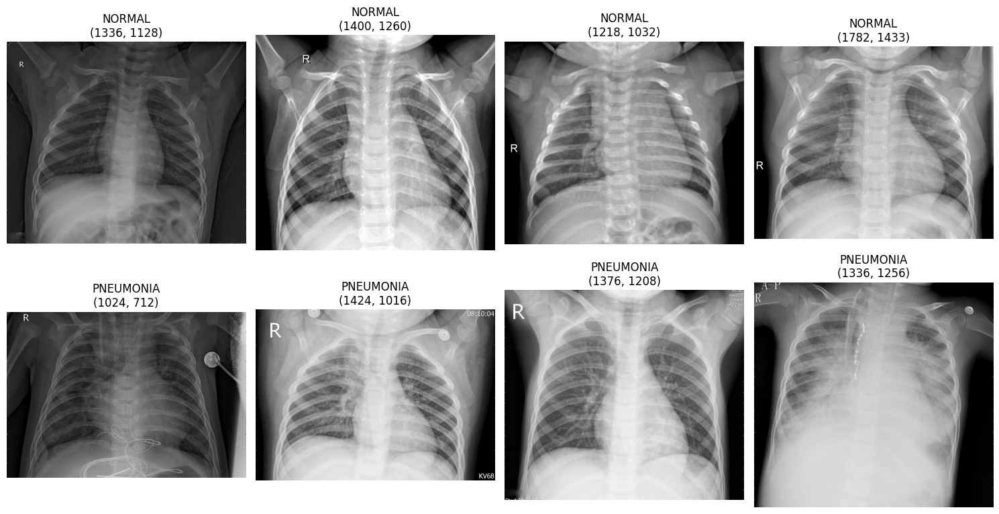

In [3]:
# Visualize sample images from training set
def plot_samples(directory, num_samples=8):
    normal_dir = os.path.join(directory, 'NORMAL')
    pneumonia_dir = os.path.join(directory, 'PNEUMONIA')
    
    fig, axes = plt.subplots(2, 4, figsize=(15, 8))
    
    # Plot Normal X-rays
    normal_images = os.listdir(normal_dir)[:4]
    for i, img_name in enumerate(normal_images):
        img_path = os.path.join(normal_dir, img_name)
        img = Image.open(img_path)
        axes[0, i].imshow(img, cmap='gray')
        axes[0, i].set_title(f'NORMAL\n{img.size}')
        axes[0, i].axis('off')
    
    # Plot Pneumonia X-rays
    pneumonia_images = os.listdir(pneumonia_dir)[:4]
    for i, img_name in enumerate(pneumonia_images):
        img_path = os.path.join(pneumonia_dir, img_name)
        img = Image.open(img_path)
        axes[1, i].imshow(img, cmap='gray')
        axes[1, i].set_title(f'PNEUMONIA\n{img.size}')
        axes[1, i].axis('off')
    
    plt.tight_layout()
    plt.show()

plot_samples(train_dir)


In [4]:
# Image parameters
IMG_HEIGHT = 224
IMG_WIDTH = 224
BATCH_SIZE = 32

# Data augmentation for training set
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=15,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    zoom_range=0.1,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Only rescaling for validation and test sets
val_test_datagen = ImageDataGenerator(rescale=1./255)

# Create data generators
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(IMG_HEIGHT, IMG_WIDTH),
    batch_size=BATCH_SIZE,
    class_mode='binary',
    shuffle=True
)

val_generator = val_test_datagen.flow_from_directory(
    val_dir,
    target_size=(IMG_HEIGHT, IMG_WIDTH),
    batch_size=BATCH_SIZE,
    class_mode='binary',
    shuffle=False
)

test_generator = val_test_datagen.flow_from_directory(
    test_dir,
    target_size=(IMG_HEIGHT, IMG_WIDTH),
    batch_size=BATCH_SIZE,
    class_mode='binary',
    shuffle=False
)

print(f"\nClass Indices: {train_generator.class_indices}")
print(f"Training samples: {train_generator.samples}")
print(f"Validation samples: {val_generator.samples}")
print(f"Test samples: {test_generator.samples}")


Found 5216 images belonging to 2 classes.
Found 16 images belonging to 2 classes.
Found 624 images belonging to 2 classes.

Class Indices: {'NORMAL': 0, 'PNEUMONIA': 1}
Training samples: 5216
Validation samples: 16
Test samples: 624


In [5]:
# Transfer Learning with VGG16 
def build_vgg16_model():
    # Load pre-trained VGG16 without top layers
    base_model = VGG16(
        weights='imagenet',
        include_top=False,
        input_shape=(IMG_HEIGHT, IMG_WIDTH, 3)
    )
    
    # Freeze base model layers
    for layer in base_model.layers:
        layer.trainable = False
    
    # Add custom classification head
    x = GlobalAveragePooling2D()(base_model.output)
    x = Dense(512, activation='relu')(x)
    x = BatchNormalization()(x)
    x = Dropout(0.5)(x)
    x = Dense(256, activation='relu')(x)
    x = BatchNormalization()(x)
    x = Dropout(0.3)(x)
    predictions = Dense(1, activation='sigmoid')(x)
    
    model = Model(inputs=base_model.input, outputs=predictions)
    
    return model

# Uncomment to use VGG16 instead of simple CNN
model = build_vgg16_model()
model.summary()


I0000 00:00:1765719201.045035      38 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13942 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5
I0000 00:00:1765719201.045659      38 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 13942 MB memory:  -> device: 1, name: Tesla T4, pci bus id: 0000:00:05.0, compute capability: 7.5


58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv1 (Conv2D)           │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_conv2 (Conv2D)           │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block1_pool (MaxPooling2D)      │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv1 (Conv2D)           │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_conv2 (Conv2D)           │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block2_pool (MaxPooling2D)      │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv1 (Conv2D)           │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv2 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_conv3 (Conv2D)           │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block3_pool (MaxPooling2D)      │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv1 (Conv2D)           │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv2 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_conv3 (Conv2D)           │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block4_pool (MaxPooling2D)      │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv1 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv2 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_conv3 (Conv2D)           │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ block5_pool (MaxPooling2D)      │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 512)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 512)            │       262,656 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 512)            │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 256)            │       131,32

 Total params: 15,112,001 (57.65 MB)

 Trainable params: 395,777 (1.51 MB)

 Non-trainable params: 14,716,224 (56.14 MB)

In [6]:
# Compile the model
model.compile(
    optimizer=Adam(learning_rate=0.0001),
    loss='binary_crossentropy',
    metrics=[
        'accuracy',
        keras.metrics.Precision(name='precision'),
        keras.metrics.Recall(name='recall'),
        keras.metrics.AUC(name='auc')
    ]
)


In [7]:
# Define callbacks
callbacks = [
    EarlyStopping(
        monitor='val_loss',
        patience=10,
        restore_best_weights=True,
        verbose=1
    ),
    ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.5,
        patience=3,
        min_lr=1e-7,
        verbose=1
    ),
    ModelCheckpoint(
        'best_pneumonia_model.h5',
        monitor='val_accuracy',
        save_best_only=True,
        verbose=1
    )
]


In [8]:
# Train the model
EPOCHS = 30

history = model.fit(
    train_generator,
    epochs=EPOCHS,
    validation_data=val_generator,
    callbacks=callbacks,
    verbose=1
)

print("\nTraining completed!")
model.save('/kaggle/working/pneumonia_detector.h5')


Epoch 1/30


I0000 00:00:1765719209.335285     126 service.cc:148] XLA service 0x794094006250 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1765719209.336586     126 service.cc:156]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
I0000 00:00:1765719209.336607     126 service.cc:156]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
I0000 00:00:1765719209.923354     126 cuda_dnn.cc:529] Loaded cuDNN version 90300


  1/163 ━━━━━━━━━━━━━━━━━━━━ 47:19 18s/step - accuracy: 0.5000 - auc: 0.4583 - loss: 1.0111 - precision: 0.7000 - recall: 0.5833

I0000 00:00:1765719221.957561     126 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 692ms/step - accuracy: 0.7129 - auc: 0.8162 - loss: 0.6299 - precision: 0.9079 - recall: 0.6798
Epoch 1: val_accuracy improved from -inf to 0.50000, saving model to best_pneumonia_model.h5
163/163 ━━━━━━━━━━━━━━━━━━━━ 139s 751ms/step - accuracy: 0.7133 - auc: 0.8167 - loss: 0.6291 - precision: 0.9081 - recall: 0.6802 - val_accuracy: 0.5000 - val_auc: 0.9766 - val_loss: 0.8585 - val_precision: 0.5000 - val_recall: 1.0000 - learning_rate: 1.0000e-04
Epoch 2/30
163/163 ━━━━━━━━━━━━━━━━━━━━ 0s 558ms/step - accuracy: 0.8572 - auc: 0.9483 - loss: 0.3707 - precision: 0.9697 - recall: 0.8331
Epoch 2: val_accuracy improved from 0.50000 to 0.56250, saving model to best_pneumonia_model.h5
163/163 ━━━━━━━━━━━━━━━━━━━━ 92s 561ms/step - accuracy: 0.8573 - auc: 0.9483 - loss: 0.3705 - precision: 0.9697 - recall: 0.8332 - val_accuracy: 0.5625 - val_auc: 1.0000 - val_loss: 0.8012 - val_precision: 0.5333 - val_recall: 1.0000 - learning_rate: 1.0000e-04
Epoch 3/30
163/163 

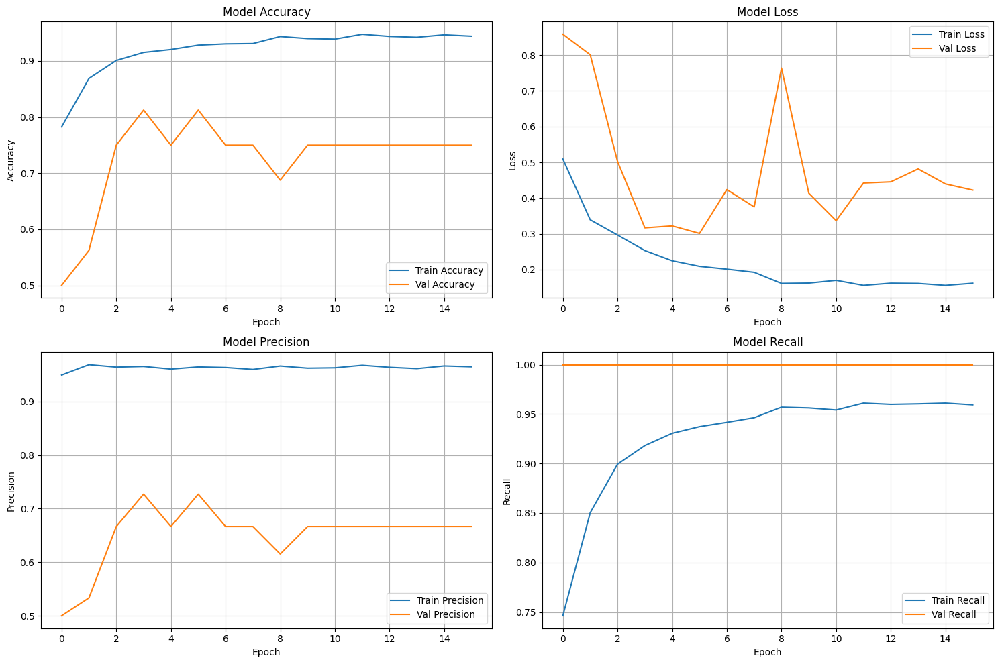

In [9]:
# Plot training history
def plot_training_history(history):
    fig, axes = plt.subplots(2, 2, figsize=(15, 10))
    
    # Accuracy
    axes[0, 0].plot(history.history['accuracy'], label='Train Accuracy')
    axes[0, 0].plot(history.history['val_accuracy'], label='Val Accuracy')
    axes[0, 0].set_title('Model Accuracy')
    axes[0, 0].set_xlabel('Epoch')
    axes[0, 0].set_ylabel('Accuracy')
    axes[0, 0].legend()
    axes[0, 0].grid(True)
    
    # Loss
    axes[0, 1].plot(history.history['loss'], label='Train Loss')
    axes[0, 1].plot(history.history['val_loss'], label='Val Loss')
    axes[0, 1].set_title('Model Loss')
    axes[0, 1].set_xlabel('Epoch')
    axes[0, 1].set_ylabel('Loss')
    axes[0, 1].legend()
    axes[0, 1].grid(True)
    
    # Precision
    axes[1, 0].plot(history.history['precision'], label='Train Precision')
    axes[1, 0].plot(history.history['val_precision'], label='Val Precision')
    axes[1, 0].set_title('Model Precision')
    axes[1, 0].set_xlabel('Epoch')
    axes[1, 0].set_ylabel('Precision')
    axes[1, 0].legend()
    axes[1, 0].grid(True)
    
    # Recall
    axes[1, 1].plot(history.history['recall'], label='Train Recall')
    axes[1, 1].plot(history.history['val_recall'], label='Val Recall')
    axes[1, 1].set_title('Model Recall')
    axes[1, 1].set_xlabel('Epoch')
    axes[1, 1].set_ylabel('Recall')
    axes[1, 1].legend()
    axes[1, 1].grid(True)
    
    plt.tight_layout()
    plt.show()

plot_training_history(history)


In [10]:
# Evaluate on test set
test_loss, test_acc, test_precision, test_recall, test_auc = model.evaluate(test_generator)

print(f"\n{'='*50}")
print(f"TEST SET RESULTS:")
print(f"{'='*50}")
print(f"Test Accuracy:  {test_acc:.4f} ({test_acc*100:.2f}%)")
print(f"Test Precision: {test_precision:.4f}")
print(f"Test Recall:    {test_recall:.4f}")
print(f"Test AUC:       {test_auc:.4f}")
print(f"{'='*50}")


20/20 ━━━━━━━━━━━━━━━━━━━━ 7s 314ms/step - accuracy: 0.8525 - auc: 0.6269 - loss: 0.3749 - precision: 0.4916 - recall: 0.6460

TEST SET RESULTS:
Test Accuracy:  0.8974 (89.74%)
Test Precision: 0.8756
Test Recall:    0.9744
Test AUC:       0.9390


20/20 ━━━━━━━━━━━━━━━━━━━━ 7s 269ms/step


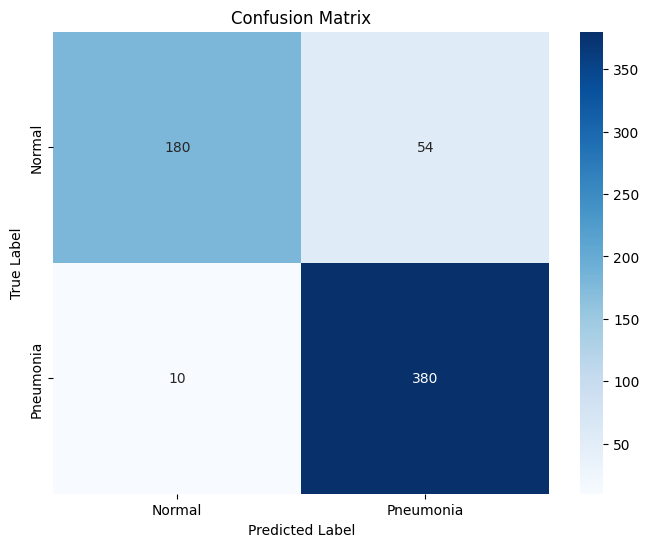


Classification Report:
              precision    recall  f1-score   support

      Normal       0.95      0.77      0.85       234
   Pneumonia       0.88      0.97      0.92       390

    accuracy                           0.90       624
   macro avg       0.91      0.87      0.89       624
weighted avg       0.90      0.90      0.89       624



In [11]:
# Get predictions
test_generator.reset()
y_pred_probs = model.predict(test_generator, verbose=1)
y_pred = (y_pred_probs > 0.5).astype(int).flatten()
y_true = test_generator.classes

# Confusion Matrix
cm = confusion_matrix(y_true, y_pred)

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Normal', 'Pneumonia'],
            yticklabels=['Normal', 'Pneumonia'])
plt.title('Confusion Matrix')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()

# Classification Report
print("\nClassification Report:")
print(classification_report(y_true, y_pred, target_names=['Normal', 'Pneumonia']))


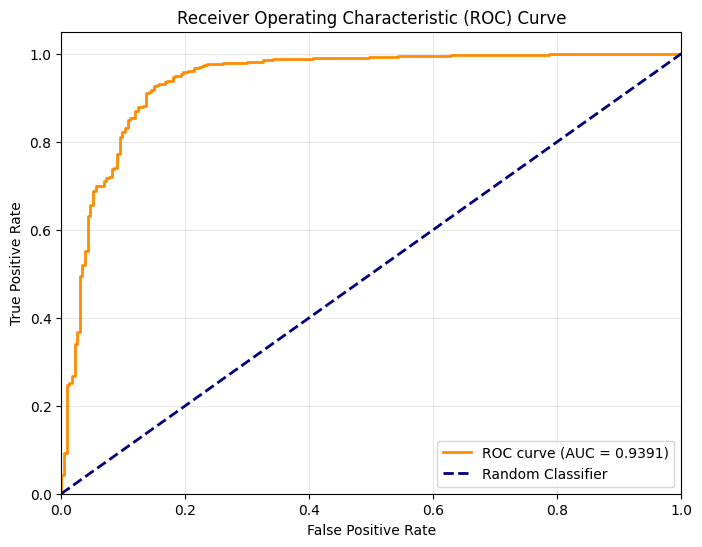

In [12]:
# Plot ROC Curve
fpr, tpr, thresholds = roc_curve(y_true, y_pred_probs)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (AUC = {roc_auc:.4f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--', label='Random Classifier')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.legend(loc="lower right")
plt.grid(True, alpha=0.3)
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 833ms/step


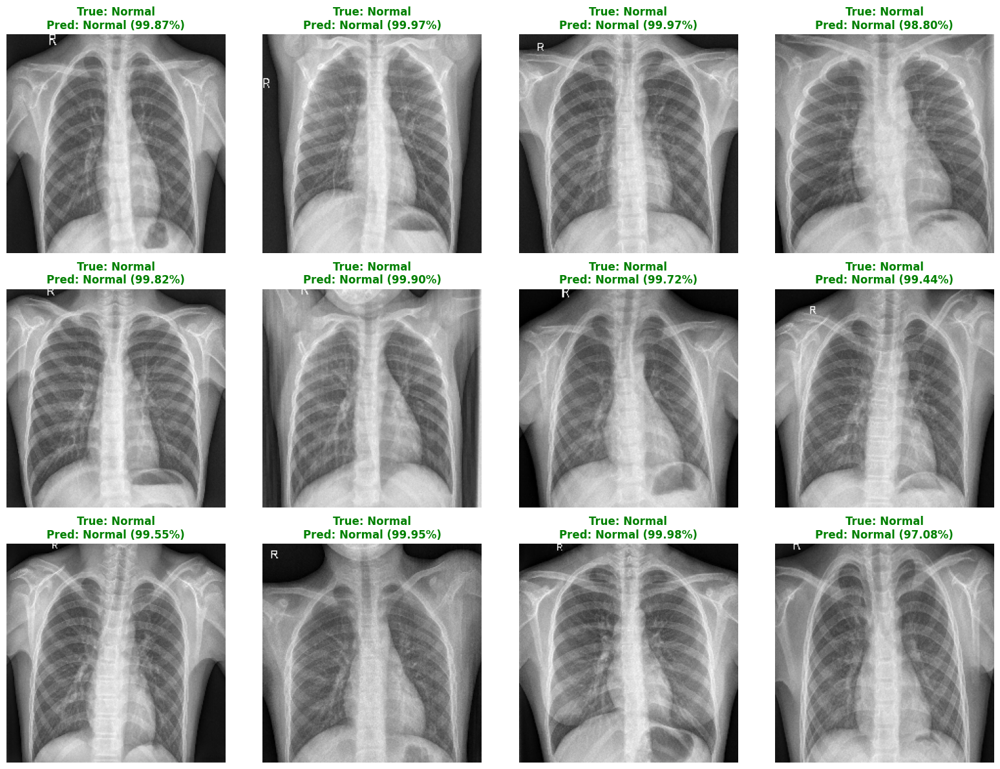

In [13]:
# Visualize predictions on test images
def visualize_predictions(generator, model, num_images=12):
    generator.reset()
    x_batch, y_batch = next(generator)
    predictions = model.predict(x_batch)
    
    fig, axes = plt.subplots(3, 4, figsize=(16, 12))
    axes = axes.ravel()
    
    for i in range(min(num_images, len(x_batch))):
        axes[i].imshow(x_batch[i])
        
        true_label = 'Pneumonia' if y_batch[i] == 2 else 'Normal'
        pred_label = 'Pneumonia' if predictions[i] > 0.5 else 'Normal'
        confidence = predictions[i][0] if predictions[i] > 0.5 else 1 - predictions[i][0]
        
        color = 'green' if true_label == pred_label else 'red'
        axes[i].set_title(f'True: {true_label}\nPred: {pred_label} ({confidence:.2%})', 
                         color=color, fontweight='bold')
        axes[i].axis('off')
    
    plt.tight_layout()
    plt.show()

visualize_predictions(test_generator, model)


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 822ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 240ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 231ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step


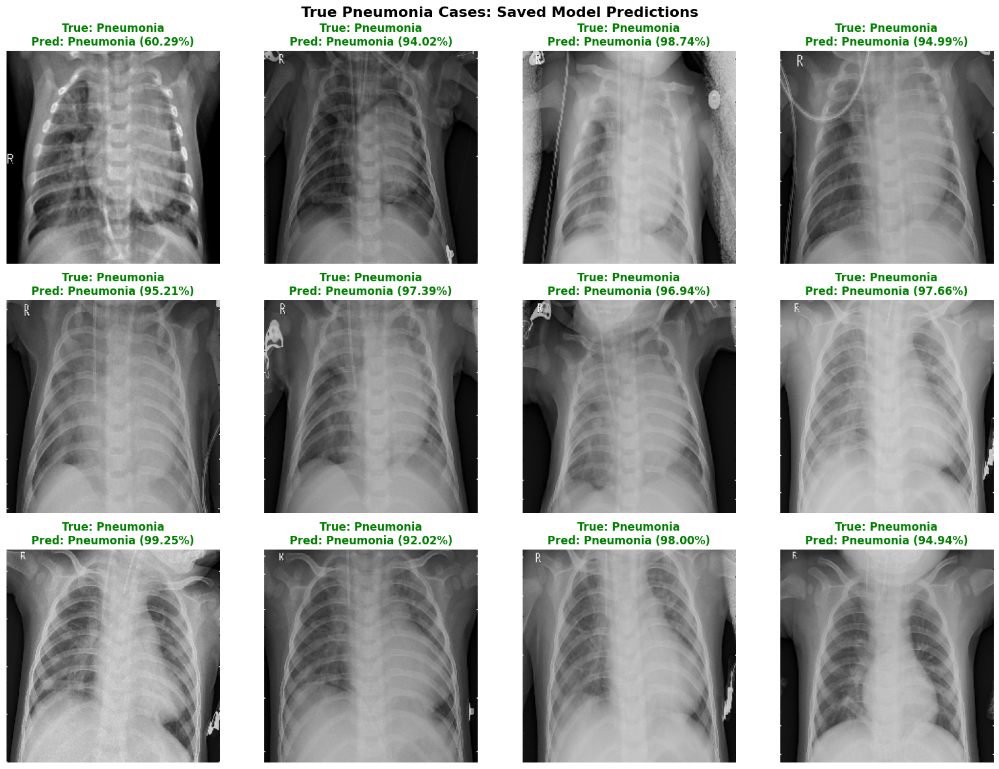

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 224ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 222ms/step


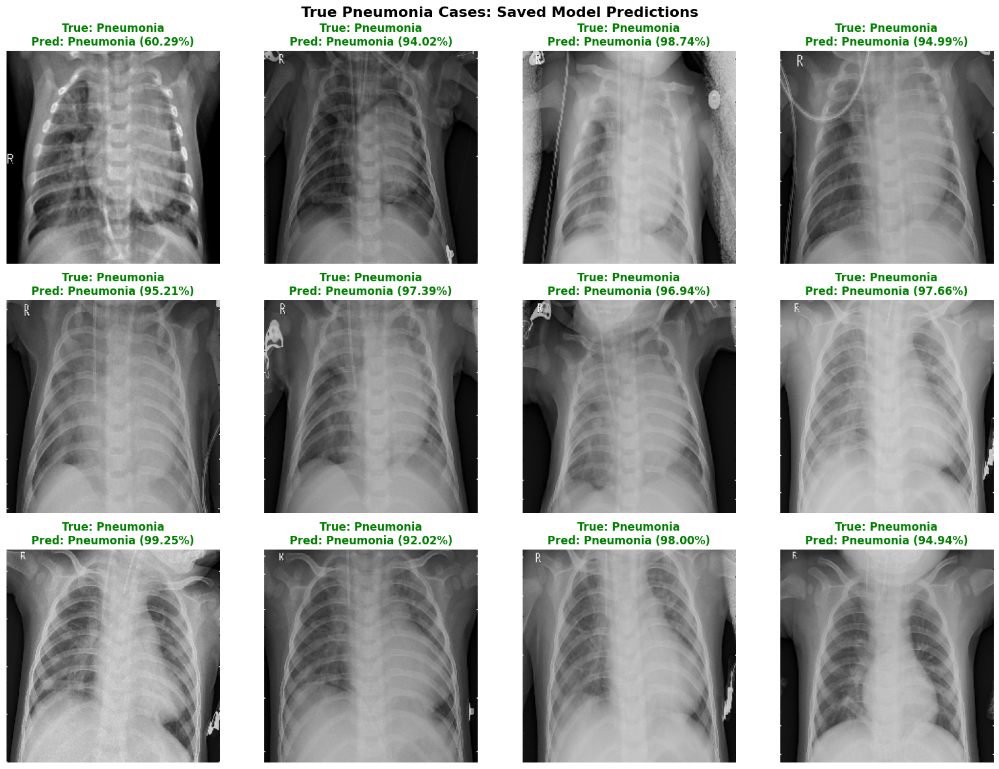

In [14]:
from tensorflow.keras.models import load_model


model = load_model('/kaggle/working/pneumonia_detector.h5')
def visualize_pneumonia_predictions(generator, model, num_images=12):
    """
    Visualizes model predictions for true Pneumonia cases in a test data generator.
    """
    generator.reset()
    collected = 0
    collected_x = []
    collected_true = []
    collected_pred = []

    while collected < num_images:
        x_batch, y_batch = next(generator)
        preds = model.predict(x_batch)
        for i in range(len(y_batch)):
            if y_batch[i] == 1:
                collected_x.append(x_batch[i])
                collected_true.append(y_batch[i])
                collected_pred.append(preds[i][0])
                collected += 1
                if collected >= num_images:
                    break

    import matplotlib.pyplot as plt
    fig, axes = plt.subplots(3, 4, figsize=(16, 12))
    axes = axes.ravel()

    for i in range(num_images):
        axes[i].imshow(collected_x[i])
        true_label = 'Pneumonia'
        pred_label = 'Pneumonia' if collected_pred[i] > 0.5 else 'Normal'
        confidence = collected_pred[i] if collected_pred[i] > 0.5 else 1 - collected_pred[i]
        color = 'green' if true_label == pred_label else 'red'
        axes[i].set_title(
            f'True: {true_label}\nPred: {pred_label} ({confidence:.2%})',
            color=color, fontweight='bold'
        )
        axes[i].axis('off')

    plt.suptitle("True Pneumonia Cases: Saved Model Predictions", fontsize=16, fontweight='bold')
    plt.tight_layout()
    plt.show()

# Usage:
visualize_pneumonia_predictions(test_generator, model, num_images=12)

# Usage (after loading your saved model):
visualize_pneumonia_predictions(test_generator, model, num_images=12)


Image path: /kaggle/input/test12/test2.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Prediction: Pneumonia (95.99% confidence)


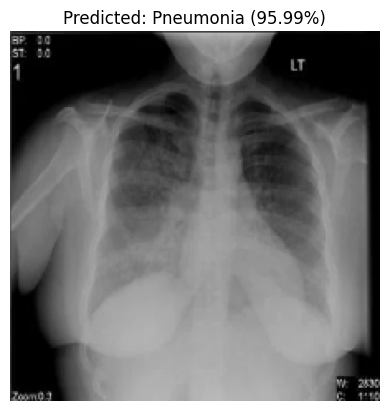

In [15]:
from tensorflow.keras.preprocessing import image
import numpy as np
import matplotlib.pyplot as plt
import os


test_normal_dir = '/kaggle/input/chest-xray-pneumonia/chest_xray/test/NORMAL'
test_pneumonia_dir = '/kaggle/input/chest-xray-pneumonia/chest_xray/test/PNEUMONIA'

# Pneumonia image
# img_filename = os.listdir(test_pneumonia_dir)[0]
# img_path = os.path.join(test_pneumonia_dir, img_filename)

# Normal image
# img_filename = os.listdir(test_normal_dir)[0]
# img_path = os.path.join(test_normal_dir, img_filename)
img_path = '/kaggle/input/test12/test2.jpg' 

print(f"Image path: {img_path}")

# Load and preprocess image
img = image.load_img(img_path, target_size=(224, 224))
img_array = image.img_to_array(img)
img_array = img_array / 255.0
img_array = np.expand_dims(img_array, axis=0)

# Predict
prediction = model.predict(img_array)
pred_label = 'Pneumonia' if prediction[0][0] > 0.5 else 'Normal'
confidence = prediction[0][0] if prediction[0][0] > 0.5 else 1 - prediction[0][0]

print(f"Prediction: {pred_label} ({confidence:.2%} confidence)")

# Visualize
plt.imshow(img)
plt.axis('off')
plt.title(f"Predicted: {pred_label} ({confidence:.2%})")
plt.show()


COMPACT 4-COLUMN VISUALIZATION - 5 NORMAL + 5 PNEUMONIA
Model loaded successfully!

Found 10 Normal images
Found 10 Pneumonia images
Total: 20 images to process

Processing NORMAL images...
  [1/10] NORMAL2-IM-0336-0001.jpeg


  0%|          | 0/500 [00:00<?, ?it/s]

  [2/10] IM-0101-0001.jpeg


  0%|          | 0/500 [00:00<?, ?it/s]

  [3/10] NORMAL2-IM-0337-0001.jpeg


  0%|          | 0/500 [00:00<?, ?it/s]

  [4/10] NORMAL2-IM-0198-0001.jpeg


  0%|          | 0/500 [00:00<?, ?it/s]

  [5/10] IM-0013-0001.jpeg


  0%|          | 0/500 [00:00<?, ?it/s]

  [6/10] IM-0103-0001.jpeg


  0%|          | 0/500 [00:00<?, ?it/s]

  [7/10] NORMAL2-IM-0139-0001.jpeg


  0%|          | 0/500 [00:00<?, ?it/s]

  [8/10] NORMAL2-IM-0313-0001.jpeg


  0%|          | 0/500 [00:00<?, ?it/s]

  [9/10] NORMAL2-IM-0340-0001.jpeg


  0%|          | 0/500 [00:00<?, ?it/s]

  [10/10] NORMAL2-IM-0378-0001.jpeg


  0%|          | 0/500 [00:00<?, ?it/s]


Processing PNEUMONIA images...
  [1/10] person1676_virus_2892.jpeg


  0%|          | 0/500 [00:00<?, ?it/s]

  [2/10] person1650_virus_2852.jpeg


  0%|          | 0/500 [00:00<?, ?it/s]

  [3/10] person22_virus_55.jpeg


  0%|          | 0/500 [00:00<?, ?it/s]

  [4/10] person122_bacteria_582.jpeg


  0%|          | 0/500 [00:00<?, ?it/s]

  [5/10] person85_bacteria_417.jpeg


  0%|          | 0/500 [00:00<?, ?it/s]

  [6/10] person79_virus_148.jpeg


  0%|          | 0/500 [00:00<?, ?it/s]

  [7/10] person29_virus_64.jpeg


  0%|          | 0/500 [00:00<?, ?it/s]

  [8/10] person123_bacteria_587.jpeg


  0%|          | 0/500 [00:00<?, ?it/s]

  [9/10] person75_virus_136.jpeg


  0%|          | 0/500 [00:00<?, ?it/s]

  [10/10] person153_bacteria_725.jpeg


  0%|          | 0/500 [00:00<?, ?it/s]


Processed 20 images!

GENERATING XAI VISUALIZATION (20 images)

Saved to /kaggle/working/xai_comparison_10images.png


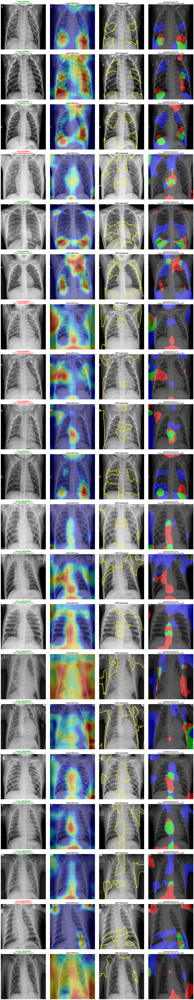


SUMMARY OF ALL RESULTS

Image                                    True         Pred         Conf     IoU      Status
-----------------------------------------------------------------------------------------------
NORMAL2-IM-0336-0001.jpeg                NORMAL       NORMAL       51.37%    0.245    OK
IM-0101-0001.jpeg                        NORMAL       NORMAL       75.46%    0.197    OK
NORMAL2-IM-0337-0001.jpeg                NORMAL       NORMAL       87.48%    0.164    OK
NORMAL2-IM-0198-0001.jpeg                NORMAL       PNEUMONIA    58.61%    0.145    WRONG
IM-0013-0001.jpeg                        NORMAL       NORMAL       88.54%    0.232    OK
IM-0103-0001.jpeg                        NORMAL       NORMAL       94.45%    0.055    OK
NORMAL2-IM-0139-0001.jpeg                NORMAL       PNEUMONIA    53.23%    0.167    WRONG
NORMAL2-IM-0313-0001.jpeg                NORMAL       PNEUMONIA    66.06%    0.134    WRONG
NORMAL2-IM-0340-0001.jpeg                NORMAL       PNEUMONIA   

In [17]:
"""
================================================================================
IMPROVED COMPACT VISUALIZATION - 5 NORMAL + 5 PNEUMONIA
Original | Grad-CAM | LIME | Agreement
================================================================================
"""

import numpy as np
import matplotlib.pyplot as plt
import cv2
import os
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.preprocessing import image
import tensorflow as tf
from lime import lime_image
from skimage.segmentation import mark_boundaries
import random
import warnings
warnings.filterwarnings('ignore')

# Suppress TensorFlow logging
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
tf.get_logger().setLevel('ERROR')

# Set seeds
np.random.seed(42)
random.seed(42)
tf.random.set_seed(42)

# Load model
model = load_model('/kaggle/input/best-pneumonia-model/best_pneumonia_model(4).h5', compile=False)
LAST_CONV_LAYER = 'block5_conv3'

print("="*80)
print("COMPACT 4-COLUMN VISUALIZATION - 5 NORMAL + 5 PNEUMONIA")
print("="*80)
print("Model loaded successfully!")


# ============================================================================
# GRAD-CAM FUNCTION
# ============================================================================

def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = Model(
        inputs=model.input,
        outputs=[model.get_layer(last_conv_layer_name).output, model.output]
    )
    
    # with tf.GradientTape() as tape:
    #     conv_outputs, predictions = grad_model(img_array)
    #     if pred_index is None:
    #         pred_index = tf.argmax(predictions[0])
    #     class_channel = predictions[:, pred_index]
    # STEP 2: Compute gradients (Binary Sigmoid fix)
    with tf.GradientTape() as tape:
        conv_outputs, preds = grad_model(img_array)  # preds shape: (1, 1)
        p = preds[:, 0]  # P(Pneumonia)

        # Explain predicted class:
        class_channel = tf.where(p > 0.5, p, 1.0 - p)

    
    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    
    # heatmap = tf.maximum(heatmap, 0) / (tf.math.reduce_max(heatmap) + 1e-10)
    heatmap = tf.maximum(heatmap, 0)
    heatmap /= (tf.reduce_max(heatmap) + 1e-8)

    return heatmap.numpy()


def apply_gradcam(img_path, model, last_conv_layer_name='block5_conv3'):
    img = image.load_img(img_path, target_size=(224, 224))
    img_array = image.img_to_array(img)
    img_array = img_array / 255.0
    img_array = np.expand_dims(img_array, axis=0)
    
    prediction = model.predict(img_array, verbose=0)
    pred_label = 'PNEUMONIA' if prediction[0][0] > 0.5 else 'NORMAL'
    confidence = prediction[0][0] if prediction[0][0] > 0.5 else 1 - prediction[0][0]
    
    heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name)
    heatmap_resized = cv2.resize(heatmap, (224, 224))
    
    heatmap_colored = cv2.applyColorMap(np.uint8(255 * heatmap_resized), cv2.COLORMAP_JET)
    heatmap_colored = cv2.cvtColor(heatmap_colored, cv2.COLOR_BGR2RGB)
    original_img_rgb = np.uint8(img_array[0] * 255)
    superimposed = cv2.addWeighted(original_img_rgb, 0.6, heatmap_colored, 0.4, 0)
    
    return original_img_rgb, heatmap_resized, superimposed, pred_label, confidence


# ============================================================================
# LIME FUNCTION
# ============================================================================

def predict_fn_for_lime(images):
    images = images / 255.0
    predictions = model.predict(images, verbose=0)
    return np.hstack([1 - predictions, predictions])


def apply_lime(img_path, model, num_samples=500):
    img = image.load_img(img_path, target_size=(224, 224))
    img_array = image.img_to_array(img)
    
    img_normalized = img_array / 255.0
    img_normalized = np.expand_dims(img_normalized, axis=0)
    prediction = model.predict(img_normalized, verbose=0)
    pred_label = 'PNEUMONIA' if prediction[0][0] > 0.5 else 'NORMAL'
    confidence = prediction[0][0] if prediction[0][0] > 0.5 else 1 - prediction[0][0]
    
    explainer = lime_image.LimeImageExplainer()
    pred_class = 1 if prediction[0][0] > 0.5 else 0
    
    # explanation = explainer.explain_instance(
    #     img_array.astype('double'),
    #     predict_fn_for_lime,
    #     top_labels=2,
    #     hide_color=0,
    #     num_samples=num_samples
    # )
    explanation = explainer.explain_instance(
        img_array.astype(np.uint8),
        predict_fn_for_lime,
        top_labels=2,
        hide_color=0,
        num_samples=num_samples
    )

    
    temp, mask = explanation.get_image_and_mask(
        pred_class,
        positive_only=True,
        num_features=5,
        hide_rest=False
    )
    
    lime_img = mark_boundaries(temp / 255.0, mask, color=(1, 1, 0), mode='thick')
    
    return img_array, lime_img, mask, pred_label, confidence


# ============================================================================
# PROCESS SINGLE IMAGE
# ============================================================================

def process_single_image(img_path, actual_label):
    """Process one image and return all results"""
    
    # Apply Grad-CAM
    orig_img, heatmap_gc, superimposed_gc, pred_gc, conf_gc = apply_gradcam(
        img_path, model, LAST_CONV_LAYER
    )
    
    # Apply LIME
    _, lime_img, mask_lime, pred_lime, conf_lime = apply_lime(img_path, model)
    
    # Compute agreement
    # ------------------------------------------------------------------
    # Compute agreement using TOP-k% Grad-CAM pixels (less heuristic)
    # ------------------------------------------------------------------

    k = 10  # top 10% hottest Grad-CAM activations

    # Threshold Grad-CAM by percentile
    th = np.percentile(heatmap_gc, 100 - k)
    gradcam_mask = (heatmap_gc >= th).astype(int)

    # Ensure LIME mask is binary
    lime_mask = (mask_lime > 0).astype(int)

    intersection = np.logical_and(gradcam_mask, lime_mask).sum()
    union = np.logical_or(gradcam_mask, lime_mask).sum()
    iou = intersection / union if union > 0 else 0

    
    # Create agreement overlay
    agreement_overlay = np.zeros((*gradcam_mask.shape, 3))
    agreement_overlay[gradcam_mask == 1] = [1, 0, 0]      # Red: Grad-CAM only
    agreement_overlay[lime_mask == 1] = [0, 0, 1]          # Blue: LIME only
    agreement_overlay[np.logical_and(gradcam_mask, lime_mask)] = [0, 1, 0]  # Green: Both
    
    agreement_img = cv2.addWeighted(
        orig_img, 0.5, 
        np.uint8(agreement_overlay * 255), 0.5, 0
    )
    
    return {
        'original': orig_img,
        'gradcam': superimposed_gc,
        'lime': lime_img,
        'agreement': agreement_img,
        'actual_label': actual_label,
        'pred_label': pred_gc,
        'confidence': conf_gc,
        'iou': iou,
        'filename': os.path.basename(img_path)
    }


# ============================================================================
# PLOT ALL RESULTS IN GRID
# ============================================================================

def plot_all_results(results_list, save_path=None):
    n = len(results_list)
    fig, axes = plt.subplots(n, 4, figsize=(24, 6*n))
    
    if n == 1:
        axes = axes.reshape(1, -1)
    
    for i, r in enumerate(results_list):
        actual = r['actual_label']
        pred = r['pred_label']
        conf = r['confidence']
        iou = r['iou']
        
        # Color based on correct/incorrect
        color = 'green' if actual.upper() == pred.upper() else 'red'
        
        # Column 1: Original
        axes[i, 0].imshow(r['original'])
        axes[i, 0].set_title(f"Actual: {actual}\nPred: {pred} ({conf:.1%})", 
                             fontsize=12, fontweight='bold', color=color)
        axes[i, 0].axis('off')
        
        # Column 2: Grad-CAM
        axes[i, 1].imshow(r['gradcam'])
        axes[i, 1].set_title('Grad-CAM Focus', fontsize=12, fontweight='bold')
        axes[i, 1].axis('off')
        
        # Column 3: LIME
        axes[i, 2].imshow(r['lime'])
        axes[i, 2].set_title('LIME Superpixels', fontsize=12, fontweight='bold')
        axes[i, 2].axis('off')
        
        # Column 4: Agreement
        axes[i, 3].imshow(r['agreement'])
        axes[i, 3].set_title(f'Agreement (IoU: {iou:.2f})\nGreen=Both, Red=GradCAM, Blue=LIME', 
                             fontsize=10, fontweight='bold')
        axes[i, 3].axis('off')
    
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, dpi=150, bbox_inches='tight', facecolor='white')
        print(f"Saved to {save_path}")
    
    plt.show()


# ============================================================================
# GET TEST IMAGES (5 Normal + 5 Pneumonia)
# ============================================================================

test_dir = '/kaggle/input/chest-xray-pneumonia/chest_xray/test'
normal_dir = os.path.join(test_dir, 'NORMAL')
pneumonia_dir = os.path.join(test_dir, 'PNEUMONIA')

# Get 5 images from each class
normal_files = [os.path.join(normal_dir, f) for f in os.listdir(normal_dir) 
                if f.lower().endswith(('jpeg', 'jpg', 'png'))][:10]
pneumonia_files = [os.path.join(pneumonia_dir, f) for f in os.listdir(pneumonia_dir) 
                   if f.lower().endswith(('jpeg', 'jpg', 'png'))][:10]

print(f"\nFound {len(normal_files)} Normal images")
print(f"Found {len(pneumonia_files)} Pneumonia images")
print(f"Total: {len(normal_files) + len(pneumonia_files)} images to process\n")


# ============================================================================
# PROCESS ALL IMAGES
# ============================================================================

all_results = []

print("Processing NORMAL images...")
for i, img_path in enumerate(normal_files):
    print(f"  [{i+1}/10] {os.path.basename(img_path)}")
    result = process_single_image(img_path, 'NORMAL')
    all_results.append(result)

print("\nProcessing PNEUMONIA images...")
for i, img_path in enumerate(pneumonia_files):
    print(f"  [{i+1}/10] {os.path.basename(img_path)}")
    result = process_single_image(img_path, 'PNEUMONIA')
    all_results.append(result)

print(f"\nProcessed {len(all_results)} images!")


# ============================================================================
# PLOT ALL RESULTS
# ============================================================================

print("\n" + "="*60)
print("GENERATING XAI VISUALIZATION (20 images)")
print("="*60 + "\n")

plot_all_results(all_results, save_path='/kaggle/working/xai_comparison_10images.png')


# ============================================================================
# SUMMARY TABLE
# ============================================================================

print("\n" + "="*80)
print("SUMMARY OF ALL RESULTS")
print("="*80)

print(f"\n{'Image':<40} {'True':<12} {'Pred':<12} {'Conf':<8} {'IoU':<8} {'Status'}")
print("-" * 95)

for r in all_results:
    status = 'OK' if r['actual_label'].upper() == r['pred_label'].upper() else 'WRONG'
    print(f"{r['filename']:<40} {r['actual_label']:<12} {r['pred_label']:<12} "
          f"{r['confidence']:.2%}    {r['iou']:.3f}    {status}")

avg_iou = np.mean([r['iou'] for r in all_results])
correct = sum(1 for r in all_results if r['actual_label'].upper() == r['pred_label'].upper())

print("-" * 95)
print(f"\nOverall Statistics:")
print(f"  Prediction Accuracy: {correct}/{len(all_results)} ({correct/len(all_results)*100:.1f}%)")
print(f"  Average Agreement (IoU): {avg_iou:.3f} ({avg_iou*100:.1f}%)")

print("\n" + "="*80)
print("DONE!")
print("="*80)